In [1]:
%config IPCompleter.greedy=True
%pylab inline

SMALL_SIZE = 14
MEDIUM_SIZE = 18
BIGGER_SIZE = 25

plt.rc('font', size=SMALL_SIZE)         # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)    # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb

Populating the interactive namespace from numpy and matplotlib


D:\Anaconda\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Music Genre Prediction

## Dataset

Dataset : https://www.kaggle.com/carlthome/gtzan-genre-collection 

We've extracted features from the original dataset


![datset-extraction-figure](./docs/DatasetCreation.jpg)

In [2]:
dataset_file = "datasets/data-v1.csv"

df = pd.read_csv(dataset_file, sep=",")

In [3]:
from sklearn import preprocessing

X = df.drop(["label", "filename"], axis=1).values

std_scale = preprocessing.StandardScaler().fit(X) # applying feature scaling because PCA uses euclidean distance to ocompute clusters

X = std_scale.transform(X)

y = df["label"].values

# Numerical and Graphical Descriptions

## What are the features types and how do the scales of the features compare with each other? 

In [4]:
df.describe()

,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,mfcc2,mfcc3,mfcc4,...,mfcc11,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.380795,0.124698,1883.001208,1865.303842,3878.803772,0.101184,-162.754063,121.255273,-29.199931,54.109434,...,-7.320438,3.900521,-2.205811,-2.243190,1.619559,-5.134632,3.043665,-6.634297,5.002622,-7.852236
std,0.082699,0.062342,522.242739,339.144108,1096.400581,0.039370,95.151859,23.111192,20.168244,16.110998,...,5.512331,5.395750,4.365042,3.977097,3.694564,3.984223,4.333503,4.096735,4.316616,4.287511
min,0.171805,0.005014,549.065530,796.514455,710.220705,0.021877,-556.024780,42.361320,-99.755829,-3.247742,...,-32.414146,-14.018186,-20.763159,-16.360909,-12.323302,-19.637094,-12.697938,-18.963448,-13.177314,-22.937521
25%,0.321059,0.082679,1461.113254,1643.098517,3034.883732,0.071043,-213.648769,104.958897,-42.612360,45.396466,...,-11.082822,0.603397,-5.172873,-4.874094,-0.737182,-7.606263,0.300295,-9.524103,2.242899,-10.705755
50%,0.385390,0.116670,1926.222388,1943.105990,4064.821254,0.097405,-138.674522,118.840340,-30.713336,54.597818,...,-7.538498,4.457320,-2.305679,-2.279468,1.757869,-5.469918,3.286095,-6.899161,5.105744,-8.184787
75%,0.439446,0.167502,2277.180673,2110.350537,4748.075456,0.128231,-95.242519,135.433762,-17.951447,64.680765,...,-3.929274,7.729157,0.444397,0.385467,4.065663,-2.710800,5.842021,-4.012571,8.109790,-5.197460
max,0.667248,0.378549,3369.517356,2611.325445,6268.003765,0.257681,15.127309,197.522858,55.721581,98.046173,...,11.871216,17.391365,13.880814,10.114944,17.297344,9.187266,22.280184,11.137421,22.338120,10.675509


We have continuous numerical features only and very different scales.

We need to scale the data if we use algorithms that use distances (Kmeans, PCA, KNN, Linear Regression etc.)

## How does the Spectral Centroid Spectroid (center of mass of the spectrogram) vary within a genre and between genres?

The **spectral** centroid is a measure used in digital signal processing to characterise a spectrum. It indicates where the center of mass of the spectrum is located. (source: wikipedia.org)

D:\Anaconda\lib\site-packages\pandas\plotting\_matplotlib\hist.py:366: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  **kwds,


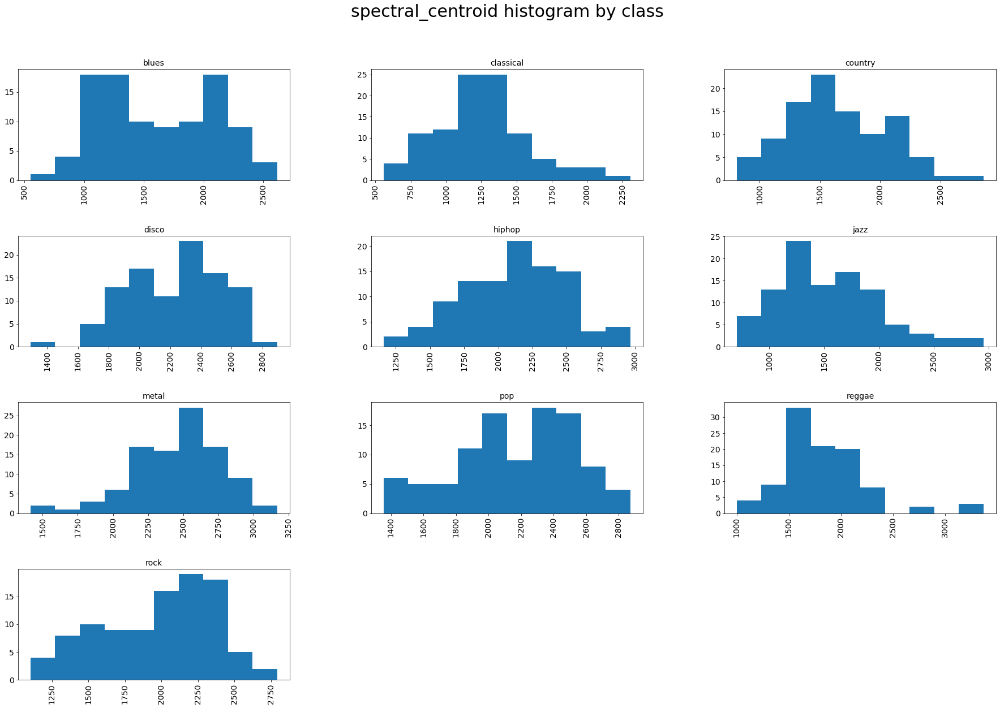

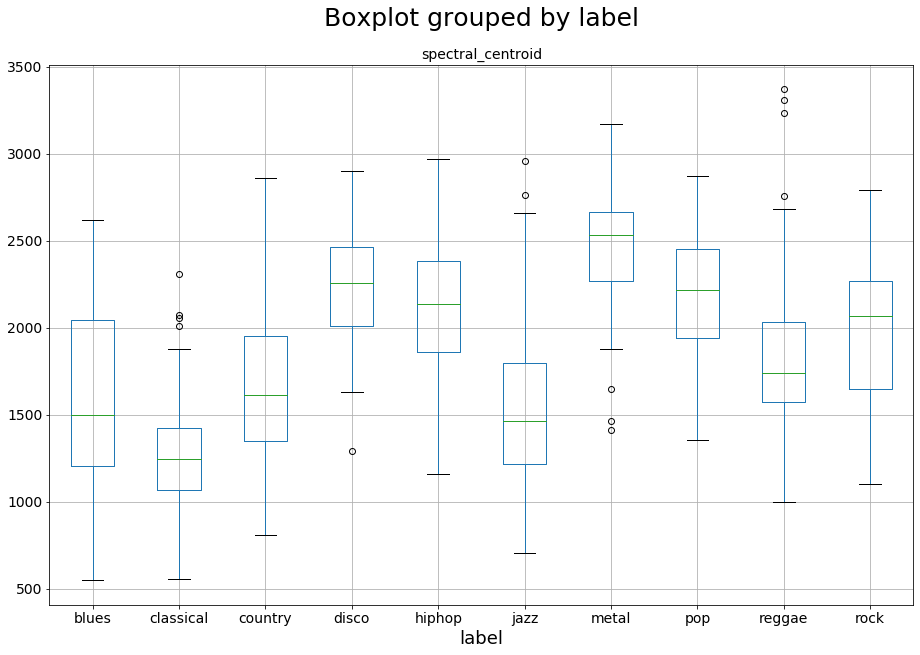

In [5]:
from ml_toolbox import plot_histograms, plot_boxes

plot_histograms(df, "spectral_centroid")
plot_boxes(df, "spectral_centroid")

The range of the Spectral Centraoid within a genre is large (a difference of 1000-2000 at least between min and max values of a genre), but 50% of songs within a "genre" are grouped together on a much smaller ranges.

The median for every genre is centered over except for reggae and metal. 

In terms of histogram, some genres like hiphop are, jazz or metal follow a positively or negatively skewed distribution wheras the others don't follow a normal distribution. 

However classical, reggae and metal have a lot of outliers. 

Classical in terms of the spectral centroid has 50% of its invididuals with a lower value than every other genre except (Jazz). Which may have an influence on how well classical music..


## Are there any correlations between features ?

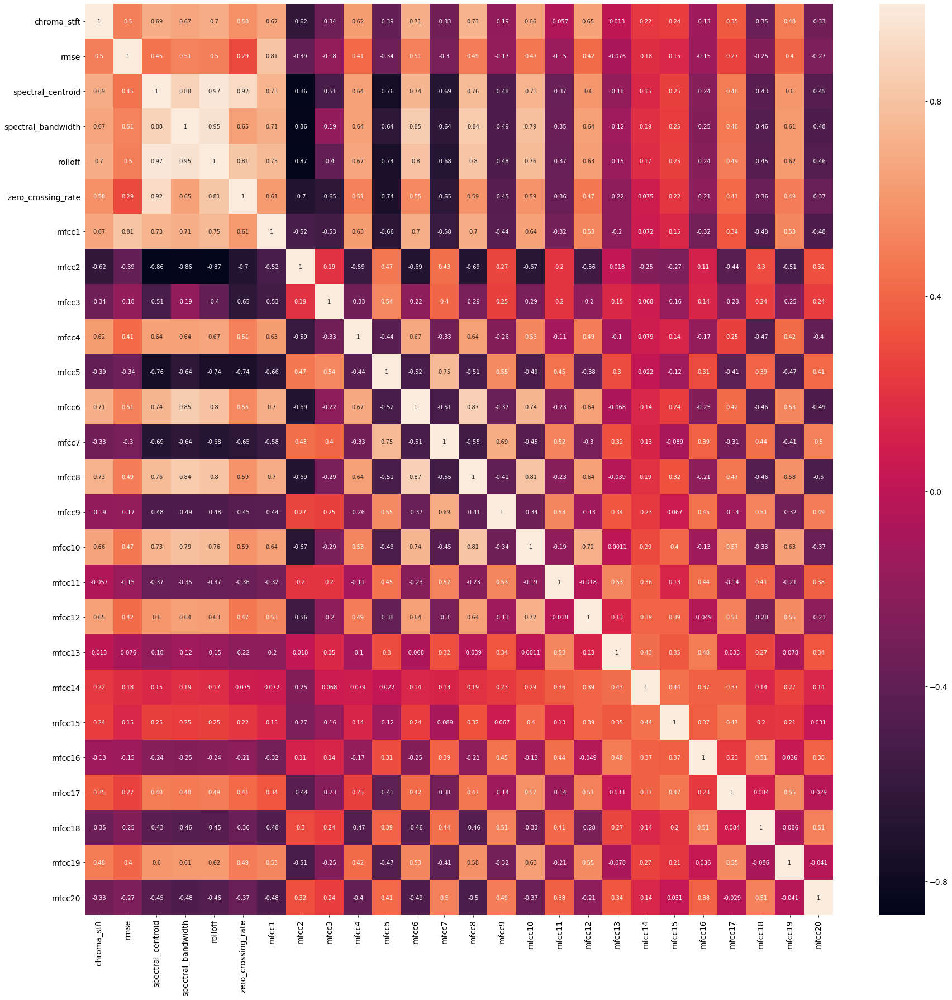

In [6]:
corrMatrix = df.corr(method="pearson")

fig, ax = plt.subplots(figsize=(30,30))   
ax = sb.heatmap(corrMatrix, annot=True)
plt.show()

We find a strong correlation between features, which is quite logicial since each feature are spectral properties obtained by some signal processing methods that perhaps.

It would be unwise to use a model such as Naive Bayes that requires features to be independant.

## Are there any clusters of genres ? 

### PCA Plot 
Using PCA to reduce dimensions of the dataset (since we are currently using 26 features)

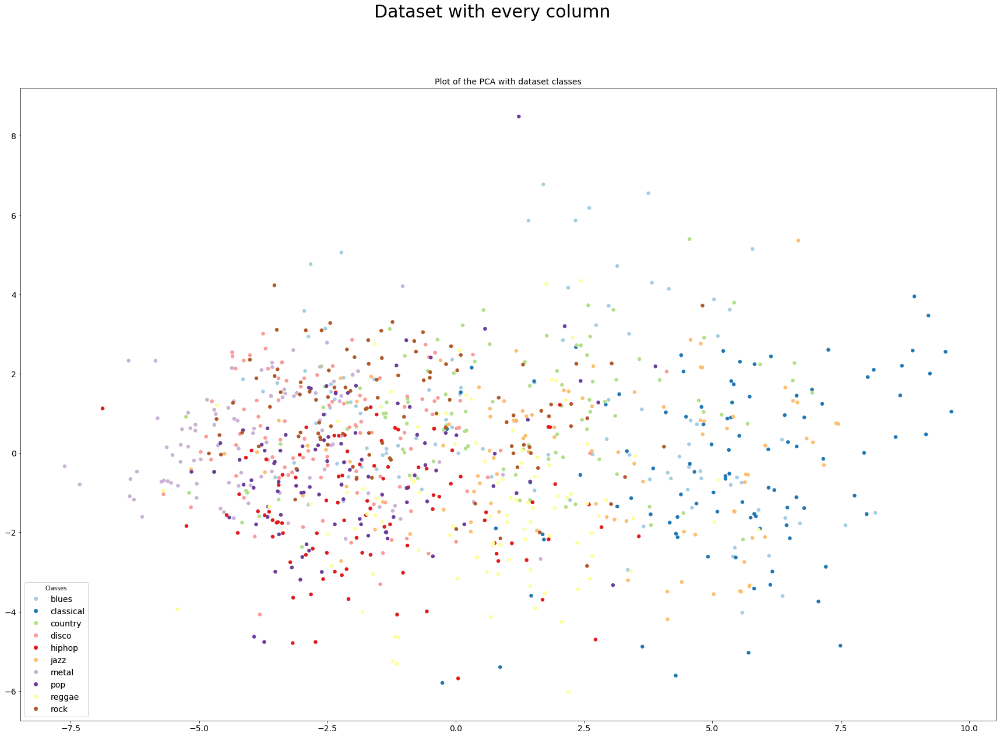

In [7]:
from ml_toolbox import show_pca

show_pca(X, y.ravel(), "Dataset with every column")

### Kmean Cluster Analysis 

In [8]:
from sklearn import cluster, metrics
     
scores = {}
    
start_range = 2
end_range = 22

for i in range(start_range,end_range):
    km = cluster.KMeans(i)
    km.fit(X)
    
    error = km.inertia_
    s_score = metrics.silhouette_score(X, km.labels_)
    
    scores[i] = {"silhouette": s_score, "error": error}

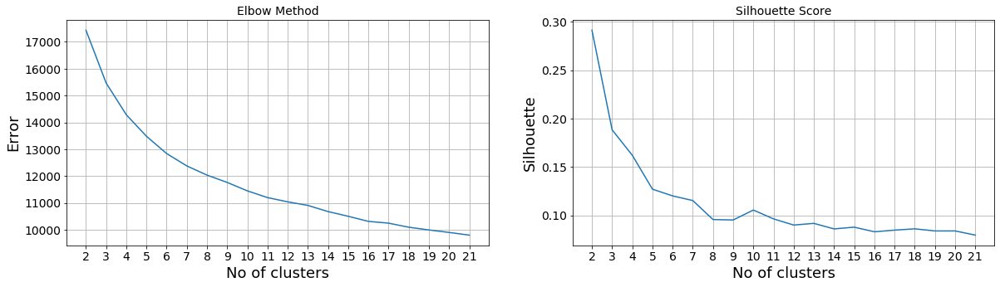

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(20,5))


ax[0].plot(range(start_range,end_range), [v["error"] for v in scores.values()])

ax[0].set_xticks(range(start_range,end_range))
ax[0].set_title("Elbow Method")
ax[0].set_xlabel("No of clusters")
ax[0].set_ylabel("Error")
ax[0].grid()


ax[1].plot(range(start_range,end_range), [v["silhouette"] for v in scores.values()])

ax[1].set_xticks(range(start_range,end_range))
ax[1].set_title("Silhouette Score")
ax[1].set_xlabel("No of clusters")
ax[1].set_ylabel("Silhouette")
ax[1].grid()

We are supposed to have 10 different genres in our dataset, however here the silhouette and the elbow method indicate that the best number of clusters is between 2 and 4, which is different from the genre groups.

Additionnaly, maximum silhouette score (for k = 2) is around 0.28 which is quite low since in theory Silhouette  is between -1 and 1 (1 meaning that the clusters are dense and well separated, 0 that the clusters are overlapping and -1 that data belong to the wrong clusters).

The dataset clearly does not seem to have a single clear cluster for each music genre. 

However the score of 0.28 for k=2 could potentially indicated that some genres can be grouped in two extra categories. Which could be an interesting feature to use.

### Hopkins Method

By plotting the PCA, the data seems too be split mixed up between music genres.

Let's verify the Hopkins score in order to determine the cluster tendency of the dataset. 
The closer the value to 1, the higher the likelihood of clusters (minimum value is 0). 

_source: https://matevzkunaver.wordpress.com/2017/06/20/hopkins-test-for-cluster-tendency/_

In [10]:
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
 
def hopkins(X):
    d = X.shape[1]
    n = len(X) # rows
    m = int(0.1 * n) # heuristic from article [1]
    nbrs = NearestNeighbors(n_neighbors=1).fit(X)
 
    rand_X = sample(range(0, n, 1), m)
 
    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X,axis=0),np.amax(X,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X[rand_X[j]].reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])
 
    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print(ujd, wjd)
        H = 0
 
    return H

hopkins_score = hopkins(X)

print("Hopkins score: %d" % hopkins_score)

Hopkins score: 0


There isn't any clustering tendency, can that turn out to be an issue in prediction? We'll see later on during the presentation...

## Which model is best for predicting music genre?

## Which audio features are most relevant for predicting music genre?

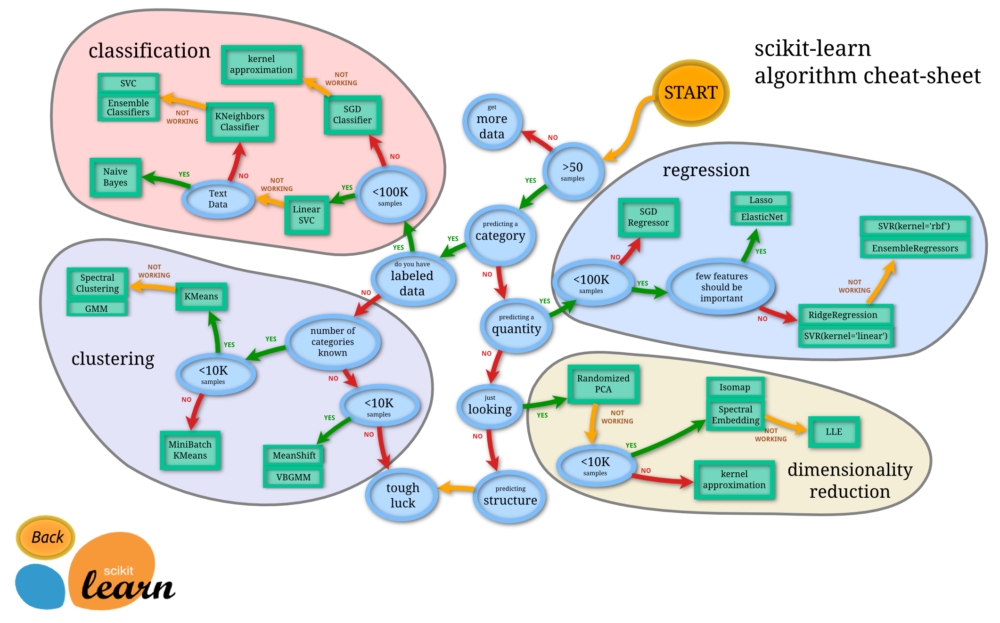


##  Linear Support Vector Classification and Librosa
### SVC Model Creation and Evaluation

In [11]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder, StandardScaler
import pandas as pd

In [12]:
#data CSV to dataframe
musicData = pd.read_csv('datasets/data-v1.csv')
print(musicData.shape)
print(musicData.head())

(1000, 28)
          filename  chroma_stft      rmse  spectral_centroid  \
0  blues.00000.mp3     0.352233  0.124096        1672.532577   
1  blues.00001.mp3     0.341906  0.091481        1397.267065   
2  blues.00002.mp3     0.365406  0.167401        1469.790929   
3  blues.00003.mp3     0.405791  0.134259         996.203757   
4  blues.00004.mp3     0.311371  0.087446        1744.625063   

   spectral_bandwidth      rolloff  zero_crossing_rate       mfcc1  \
0         1814.028373  3561.620130            0.084776 -124.778435   
1         1853.440899  3137.556028            0.056902 -217.422363   
2         1591.443680  2864.866010            0.077579 -102.581207   
3         1431.448455  2040.720993            0.034160 -205.863174   
4         1600.255520  3415.221015            0.104678 -171.341095   

        mfcc2      mfcc3  ...    mfcc12    mfcc13     mfcc14    mfcc15  \
0  132.805542 -30.837690  ...  3.946700  2.230339  -1.244802  2.800185   
1  133.360397   0.853557  ...  2.41

### First SVC - 11 features

In [13]:
#X and Y creation

X = musicData[['chroma_stft','rmse','spectral_centroid','spectral_bandwidth','rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2',
                'mfcc3','mfcc4','mfcc5']].values

y = musicData[['label']].values

#data splitting
from sklearn import preprocessing


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle = True)



# Data normalization
scaler = StandardScaler()
scaler.fit(X)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [14]:
#model creation

lsvc = LinearSVC(max_iter=100000)
print(lsvc)

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=100000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)


Score:  0.55625
CV average score: 0.53
              precision    recall  f1-score   support

       blues       0.56      0.50      0.53        18
   classical       0.86      0.95      0.90        19
     country       0.19      0.20      0.20        20
       disco       0.50      0.64      0.56        22
      hiphop       0.63      0.55      0.59        22
        jazz       0.62      0.68      0.65        19
       metal       0.74      0.89      0.81        19
         pop       0.46      0.60      0.52        20
      reggae       0.46      0.35      0.40        17
        rock       0.25      0.12      0.17        24

    accuracy                           0.54       200
   macro avg       0.53      0.55      0.53       200
weighted avg       0.52      0.54      0.52       200



D:\Anaconda\lib\site-packages\sklearn\preprocessing\_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Class 0: blues
Class 1: classical
Class 2: country
Class 3: disco
Class 4: hiphop
Class 5: jazz
Class 6: metal
Class 7: pop
Class 8: reggae
Class 9: rock


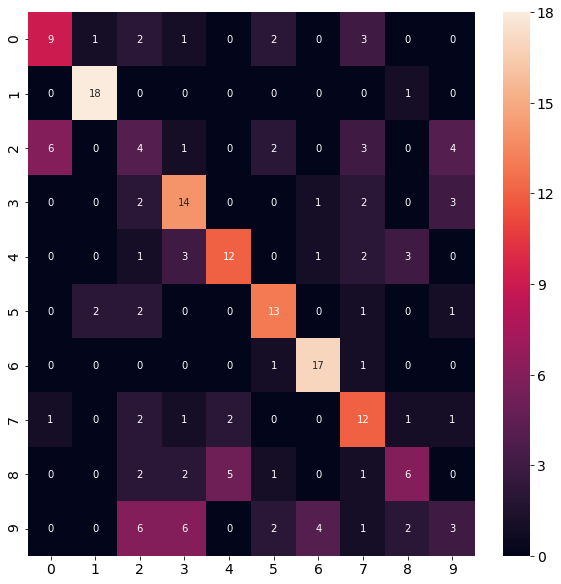

In [15]:
from ml_toolbox import show_confusion_matrix

lsvc.fit(X_train, y_train.ravel())
score = lsvc.score(X_train, y_train.ravel())
print("Score: ", score)

cv_scores = cross_val_score(lsvc, X_train, y_train.ravel(), cv=10)
print("CV average score: %.2f" % cv_scores.mean())

ypred = lsvc.predict(X_test)


cr = classification_report(y_test, ypred)
print(cr) 


encoder = preprocessing.LabelEncoder()
encoder.fit(y)

show_confusion_matrix(y_test, ypred, encoder)

### Second SVC - 26 features

In [16]:
#X and Y creation

X = musicData[['chroma_stft','rmse','spectral_centroid','spectral_bandwidth','rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2',
                'mfcc3','mfcc4','mfcc5','mfcc6','mfcc7','mfcc8','mfcc9','mfcc10','mfcc11','mfcc12','mfcc13','mfcc14','mfcc15','mfcc16',
                'mfcc17','mfcc18','mfcc19','mfcc20']].values 
y = musicData[['label']].values

#data splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle = True)

# Data normalization
scaler = StandardScaler()
scaler.fit(X)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [17]:
#model creation

lsvc = LinearSVC(max_iter=100000)
print(lsvc)

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=100000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)


Score:  0.66625
CV average score: 0.60
              precision    recall  f1-score   support

       blues       0.55      0.58      0.56        19
   classical       0.88      1.00      0.94        29
     country       0.50      0.59      0.54        22
       disco       0.41      0.33      0.37        21
      hiphop       0.71      0.55      0.62        22
        jazz       0.57      0.70      0.63        23
       metal       0.68      0.75      0.71        20
         pop       0.60      0.75      0.67        12
      reggae       0.42      0.36      0.38        14
        rock       0.40      0.22      0.29        18

    accuracy                           0.60       200
   macro avg       0.57      0.58      0.57       200
weighted avg       0.59      0.60      0.59       200

Class 0: blues
Class 1: classical
Class 2: country
Class 3: disco
Class 4: hiphop
Class 5: jazz
Class 6: metal
Class 7: pop
Class 8: reggae
Class 9: rock


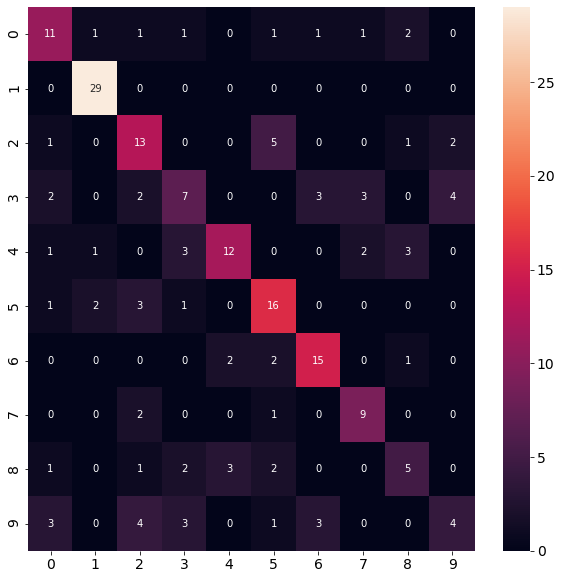

In [18]:
lsvc.fit(X_train, y_train.ravel())

score = lsvc.score(X_train, y_train.ravel())
print("Score: ", score)

cv_scores = cross_val_score(lsvc, X_train, y_train.ravel(), cv=10)
print("CV average score: %.2f" % cv_scores.mean())

ypred = lsvc.predict(X_test)

cr = classification_report(y_test, ypred)
print(cr)

show_confusion_matrix(y_test, ypred, encoder)

## Input Evaluation

Code of predict_genre within ml_toolboox.py utility file

```Python
# ml_toolboox.py
# ...

def predict_genre(model, scaler, songname, encoder = None):
    # feature exrtaction from mp3 file into numpy array
    y, sr = librosa.load(songname, mono=True, offset = 60 , duration=30)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    rmse = librosa.feature.rms(y=y)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    songdata = np.array([np.mean(chroma_stft), np.mean(rmse), np.mean(spec_cent), np.mean(spec_bw), np.mean(rolloff), np.mean(zcr)])
    for e in mfcc:
        songdata = np.append(songdata, np.mean(e))
     
    # numpy array transformation, scaling features
    songdata = songdata.reshape(1, -1)
    songdata = scaler.transform(songdata)
    
    # Model prediction
    songpred = model.predict(songdata)
    
    if encoder is  None :
        print(songname, " was identified as : " , songpred[0])
    
    else :
        songpred = encoder.transform(songpred)
        print(songname, " was identified as : " , songpred[0])
```


In [19]:
from ml_toolbox import predict_genre
import librosa
import IPython.display as ipd

songname = './audio_tracks/slipknot-duality.mp3'

predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

D:\Anaconda\lib\site-packages\librosa\core\audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
D:\Anaconda\lib\site-packages\scipy\sparse\lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):


ValueError: operands could not be broadcast together with shapes (1,64) (26,) (1,64) 

In [ ]:
songname = './audio_tracks/taylor-swift-22.mp3'

predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

In [ ]:
songname = './audio_tracks/mozart-lacrimosa.mp3'


predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

In [ ]:
songname = './audio_tracks/vivaldi-spring.mp3'


predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

In [ ]:
songname = './audio_tracks/michael-jackson-smooth-criminal.mp3'


predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

In [ ]:
songname = './audio_tracks/mobb-deep-shook-ones-pt-ii.mp3'


predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

In [ ]:
songname = './audio_tracks/bob-marley-three-little-birds.mp3'


predict_genre(lsvc, scaler, songname)

ipd.Audio(songname)

# What next?

More features using Librosa (both spectogram images and quantitative features) + KNN Model + Feature Selection using RandomForest

# SVC with CSV v2

In [51]:
#data CSV to dataframe
musicData = pd.read_csv('datasets/dataV2.csv')
print(musicData.shape)
print(musicData.head())

(1000, 66)
          filename  chroma_stft      rmse  spectral_centroid  \
0  blues.00000.mp3     0.352233  0.124096        1672.532577   
1  blues.00001.mp3     0.341906  0.091481        1397.267065   
2  blues.00002.mp3     0.365406  0.167401        1469.790929   
3  blues.00003.mp3     0.405791  0.134259         996.203757   
4  blues.00004.mp3     0.311371  0.087446        1744.625063   

   spectral_bandwidth      rolloff  zero_crossing_rate       mfcc1  \
0         1814.028373  3561.620130            0.084776 -124.778435   
1         1853.440899  3137.556028            0.056902 -217.422363   
2         1591.443680  2864.866010            0.077579 -102.581207   
3         1431.448455  2040.720993            0.034160 -205.863174   
4         1600.255520  3415.221015            0.104678 -171.341095   

        mfcc2      mfcc3  ...      cont6      cont7  spectram_flatness  \
0  132.805542 -30.837690  ...  23.591656  43.607252           0.000532   
1  133.360397   0.853557  ...  25.2

In [52]:
#X and Y creation

X = musicData.drop(["label", "filename"], axis=1).values

y = musicData[['label']].values

#data splitting
from sklearn import preprocessing


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle = True)



# Data normalization
scaler = StandardScaler()
scaler.fit(X)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [53]:
lsvc = LinearSVC(max_iter=100000)
print(lsvc)

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=100000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)


Score:  0.685
CV average score: 0.52
              precision    recall  f1-score   support

       blues       0.69      0.89      0.77        27
   classical       0.94      0.94      0.94        18
     country       0.75      0.75      0.75        20
       disco       0.80      0.59      0.68        27
      hiphop       0.52      0.73      0.61        15
        jazz       0.69      0.69      0.69        16
       metal       0.78      0.82      0.80        22
         pop       0.85      0.55      0.67        20
      reggae       0.45      0.50      0.47        18
        rock       0.36      0.29      0.32        17

    accuracy                           0.69       200
   macro avg       0.68      0.68      0.67       200
weighted avg       0.70      0.69      0.68       200

Class 0: blues
Class 1: classical
Class 2: country
Class 3: disco
Class 4: hiphop
Class 5: jazz
Class 6: metal
Class 7: pop
Class 8: reggae
Class 9: rock


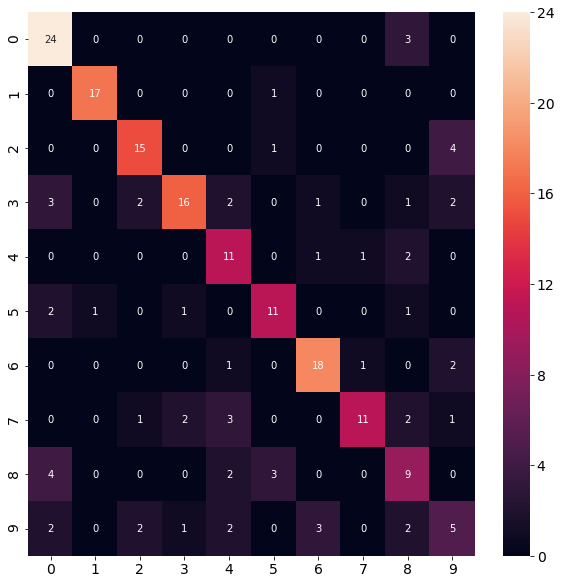

In [54]:
lsvc.fit(X_train, y_train.ravel())

score = lsvc.score(X_test, y_test.ravel())
print("Score: ", score)

cv_scores = cross_val_score(lsvc, X_test, y_test.ravel(), cv=10)
print("CV average score: %.2f" % cv_scores.mean())

ypred = lsvc.predict(X_test)

cr = classification_report(y_test, ypred)
print(cr)

show_confusion_matrix(y_test, ypred, encoder)

D:\Anaconda\lib\site-packages\sklearn\preprocessing\_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
D:\Anaconda\lib\site-packages\sklearn\preprocessing\_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[0.02037141 0.01504528 0.01669012 0.03994692 0.05591364 0.01236899
 0.01142584 0.01135828 0.01625778 0.02876819 0.01550384 0.01239981
 0.00910962 0.01726066 0.02307877 0.0102115  0.01202285 0.02512065
 0.01101806 0.01701406 0.01104319 0.00979047 0.01776373 0.01057671
 0.01087989 0.01312872 0.01386576 0.00825966 0.00752506 0.01778099
 0.01431919 0.01662024 0.00746037 0.01053908 0.0078074  0.00876968
 0.01264909 0.00816643 0.0079688  0.00834894 0.00667147 0.0134832
 0.00919112 0.00821585 0.00868063 0.0064276  0.00820241 0.0062912
 0.00863871 0.0062924  0.02002366 0.01395344 0.01029744 0.01375788
 0.08082686 0.05562158 0.01165114 0.05694965 0.00837096 0.00827679
 0.00887339 0.00872432 0.00671278 0.00971587]
[47 49 45 40 62 32 28 34 38 37 46 43 27 59 39 58 48 44 61 35 60 12 42 63
 21 15 52 33 23 24 18 20  7  6 56 16  5 11 36 25 41 53 26 51 30  1 10  8
 31  2 19 13 22 29 50  0 14 17  9  3 55  4 57 54]


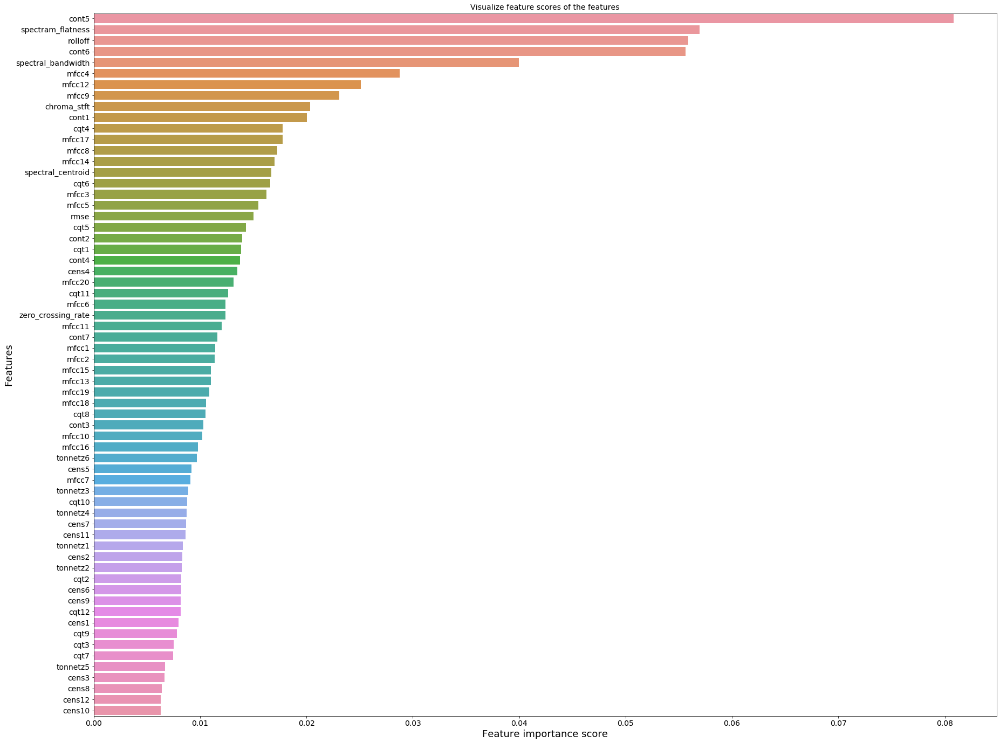

In [55]:
from sklearn.ensemble import RandomForestRegressor
import seaborn as sns


encoder = preprocessing.LabelEncoder()
encoder.fit(y)

y_encoded = encoder.transform(y)

#data splitting
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.20, shuffle = True)

# Data normalization
scaler = StandardScaler()
scaler.fit(X)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)



rf = RandomForestRegressor(n_estimators=100)

rf.fit(X_train, y_train.ravel())
rf.feature_importances_
print(rf.feature_importances_)
sorted_idx = rf.feature_importances_.argsort()

print(sorted_idx)

# view the feature scores
feature_scores = pd.Series(rf.feature_importances_, index=['chroma_stft','rmse','spectral_centroid','spectral_bandwidth','rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2',
                'mfcc3','mfcc4','mfcc5','mfcc6','mfcc7','mfcc8','mfcc9','mfcc10','mfcc11','mfcc12','mfcc13','mfcc14','mfcc15','mfcc16',
                'mfcc17','mfcc18','mfcc19','mfcc20', 'cqt1','cqt2','cqt3','cqt4','cqt5','cqt6','cqt7','cqt8','cqt9','cqt10','cqt11','cqt12',
                'cens1','cens2','cens3','cens4','cens5','cens6','cens7','cens8','cens9','cens10','cens11','cens12',
                'cont1','cont2','cont3','cont4','cont5','cont6','cont7','spectram_flatness', 'tonnetz1','tonnetz2','tonnetz3','tonnetz4','tonnetz5','tonnetz6',]).sort_values(ascending=False)

f, ax = plt.subplots(figsize=(30, 24))
ax = sns.barplot(x=feature_scores, y=feature_scores.index, data=df.T)
ax.set_title("Visualize feature scores of the features")
ax.set_yticklabels(feature_scores.index)
ax.set_xlabel("Feature importance score")
ax.set_ylabel("Features")
plt.show()

In [56]:
print(feature_scores.index)

Index(['cont5', 'spectram_flatness', 'rolloff', 'cont6', 'spectral_bandwidth',
       'mfcc4', 'mfcc12', 'mfcc9', 'chroma_stft', 'cont1', 'cqt4', 'mfcc17',
       'mfcc8', 'mfcc14', 'spectral_centroid', 'cqt6', 'mfcc3', 'mfcc5',
       'rmse', 'cqt5', 'cont2', 'cqt1', 'cont4', 'cens4', 'mfcc20', 'cqt11',
       'mfcc6', 'zero_crossing_rate', 'mfcc11', 'cont7', 'mfcc1', 'mfcc2',
       'mfcc15', 'mfcc13', 'mfcc19', 'mfcc18', 'cqt8', 'cont3', 'mfcc10',
       'mfcc16', 'tonnetz6', 'cens5', 'mfcc7', 'tonnetz3', 'cqt10', 'tonnetz4',
       'cens7', 'cens11', 'tonnetz1', 'cens2', 'tonnetz2', 'cqt2', 'cens6',
       'cens9', 'cqt12', 'cens1', 'cqt9', 'cqt3', 'cqt7', 'tonnetz5', 'cens3',
       'cens8', 'cens12', 'cens10'],
      dtype='object')


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=100000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)
Score:  0.74
CV average score: 0.50
              precision    recall  f1-score   support

       blues       0.73      0.73      0.73        15
   classical       0.93      0.93      0.93        15
     country       0.71      0.71      0.71        17
       disco       0.57      0.62      0.59        13
      hiphop       0.63      0.75      0.69        16
        jazz       0.80      0.75      0.77        16
       metal       0.87      0.87      0.87        15
         pop       0.82      0.78      0.80        18
      reggae       0.58      0.58      0.58        12
        rock       0.73      0.62      0.67        13

    accuracy                           0.74       150
   macro avg       0.74      0.73      0.73       150
weighted avg       0.74     

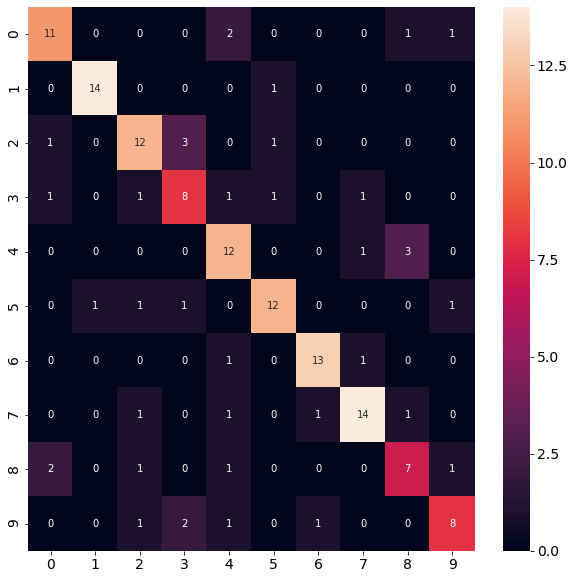

In [117]:
#X and Y creation

X = musicData.drop(["label", "filename"], axis=1).values

y = musicData[['label']].values

#data splitting
from sklearn import preprocessing


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, shuffle = True)



# Data normalization
scaler = StandardScaler()
scaler.fit(X)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

lsvc = LinearSVC(max_iter=100000)
print(lsvc)

lsvc.fit(X_train, y_train.ravel())

score = lsvc.score(X_test, y_test.ravel())
print("Score: ", score)

cv_scores = cross_val_score(lsvc, X_test, y_test.ravel(), cv=10)
print("CV average score: %.2f" % cv_scores.mean())

ypred = lsvc.predict(X_test)

cr = classification_report(y_test, ypred)
print(cr)

show_confusion_matrix(y_test, ypred, encoder)

In [118]:
def predict_genre_lsvc(model, scaler, songname, encoder = None):
    
    y, sr = librosa.load(songname, mono=True, offset = 60 , duration=30)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    rmse = librosa.feature.rms(y=y)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    
    #added 10/02
    chroma_cqt = librosa.feature.chroma_cqt(y=y, sr = sr)
    chroma_cens = librosa.feature.chroma_cens(y=y, sr = sr)
    spec_con = librosa.feature.spectral_contrast(y=y, sr=sr)
    spec_flat = librosa.feature.spectral_flatness(y=y)
    tonnetz = librosa.feature.tonnetz(y = y, sr = sr)
    
    songdata = np.array([np.mean(chroma_stft), np.mean(rmse), np.mean(spec_cent), np.mean(spec_bw), np.mean(rolloff), np.mean(zcr)])
    for e in mfcc:
        songdata = np.append(songdata, np.mean(e))
    for f in chroma_cqt :
        songdata = np.append(songdata, np.mean(f))
    for h in chroma_cens :
        songdata = np.append(songdata, np.mean(h))
    for i in spec_con :
        songdata = np.append(songdata, np.mean(i))
    for j in spec_flat :
        songdata = np.append(songdata, np.mean(j))
    for k in tonnetz :
        songdata = np.append(songdata, np.mean(k))  
     
    songdata = songdata.reshape(1, -1)
    songdata = scaler.transform(songdata)
    songpred = model.predict(songdata)
    
    if encoder is  None :
        print(songname, " was identified as : " , songpred[0])
    
    else :
        songpred = encoder.transform(songpred)
        print(songname, " was identified as : " , songpred[0])

In [119]:
songname = './audio_tracks/slipknot-duality.mp3'

predict_genre_lsvc(lsvc, scaler, songname)

ipd.Audio(songname)

D:\Anaconda\lib\site-packages\librosa\core\audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
D:\Anaconda\lib\site-packages\scipy\sparse\lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):


./audio_tracks/slipknot-duality.mp3  was identified as :  hiphop


In [120]:
songname = './audio_tracks/taylor-swift-22.mp3'

predict_genre_lsvc(lsvc, scaler, songname)

ipd.Audio(songname)

D:\Anaconda\lib\site-packages\librosa\core\audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
D:\Anaconda\lib\site-packages\scipy\sparse\lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):


./audio_tracks/taylor-swift-22.mp3  was identified as :  pop


In [121]:
songname = './audio_tracks/mozart-lacrimosa.mp3'


predict_genre_lsvc(lsvc, scaler, songname)

ipd.Audio(songname)

D:\Anaconda\lib\site-packages\librosa\core\audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
D:\Anaconda\lib\site-packages\scipy\sparse\lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):


./audio_tracks/mozart-lacrimosa.mp3  was identified as :  country
